In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
li_sprott_trajs = np.load("predicts/10Trajectorys_predicts.npy")
ross_trajs = np.load("predicts/10Trajectorys_predictsRossler.npy")

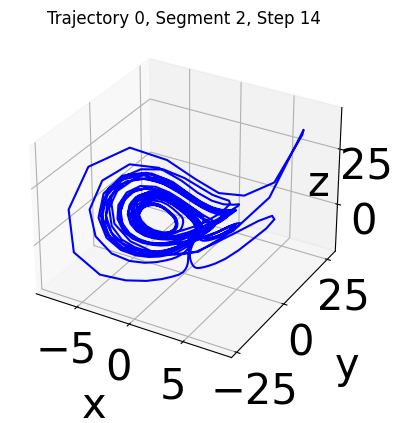

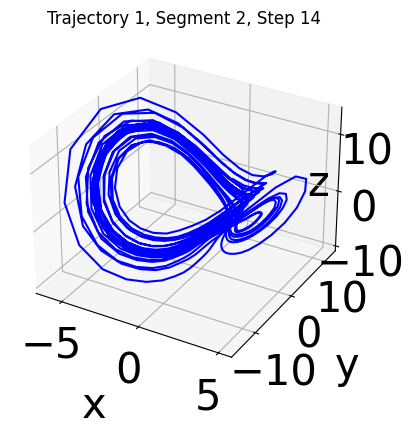

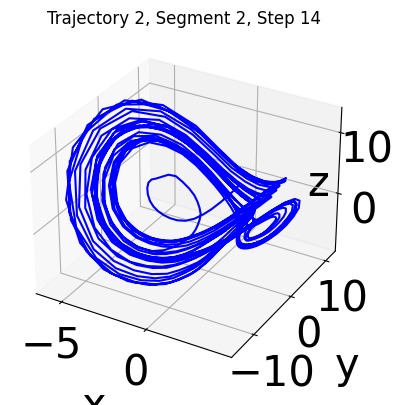

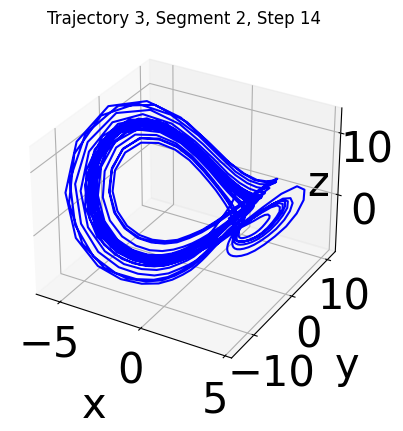

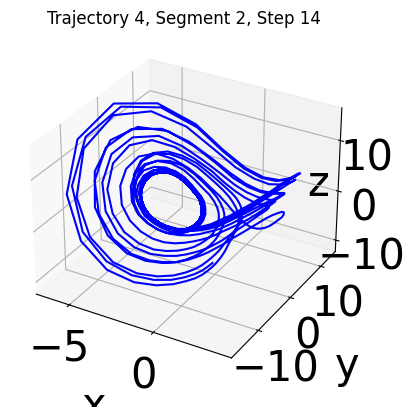

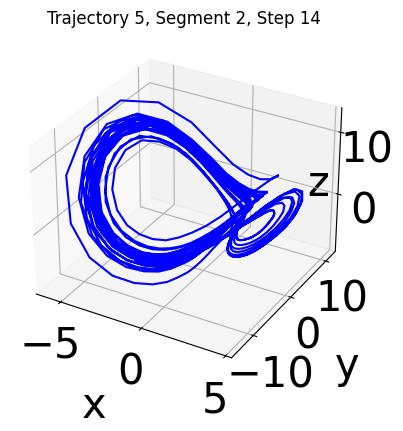

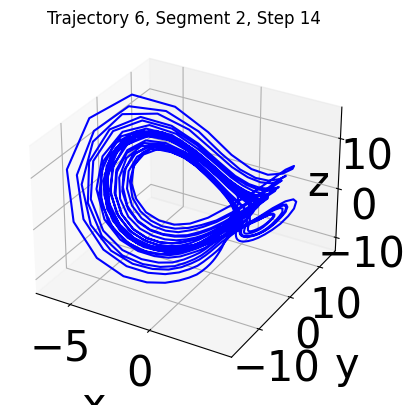

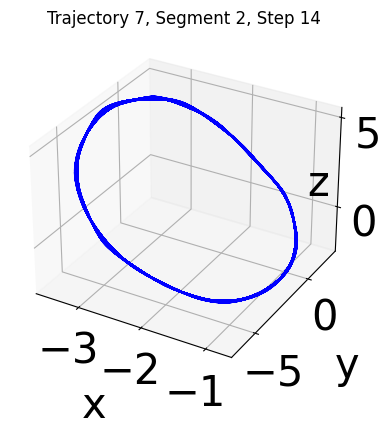

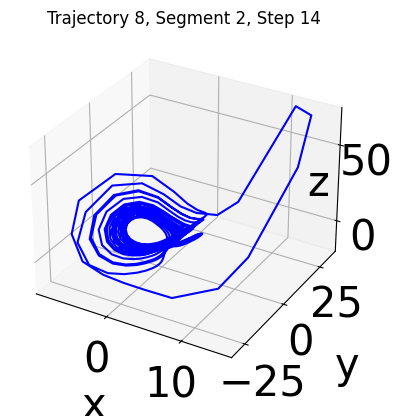

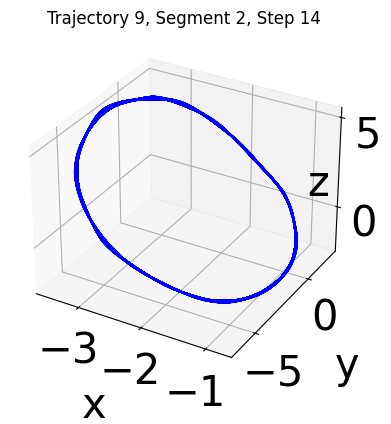

In [12]:
trajectorys_shifts = []
for traj_idx, traj in enumerate(li_sprott_trajs):
    all_change = []
    for i in range(2, 3):
        c = 0
        for j in range(14, 15):
            
            fig = plt.figure(figsize=(8, 4))
            ax = fig.add_subplot(projection='3d')
            ax.plot(traj[i][j][-1000:, 0], traj[i][j][-1000:, 1], traj[i][j][-1000:, 2], color="blue")

            ax.set_xlabel("x", size=30, labelpad=20)
            ax.set_ylabel("y", size=30, labelpad=20)
            ax.set_zlabel("z", size=30, labelpad=-30)

            ax.tick_params(axis='both', which='major', labelsize=30)
            plt.title(f'Trajectory {traj_idx}, Segment {i}, Step {j}')

            plt.tight_layout()

            plt.show()
                
        all_change.append(c)
    trajectorys_shifts.append(all_change)

only 1 reservoir fails, but 6 times

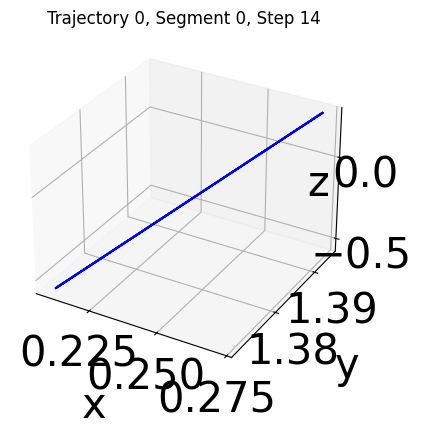

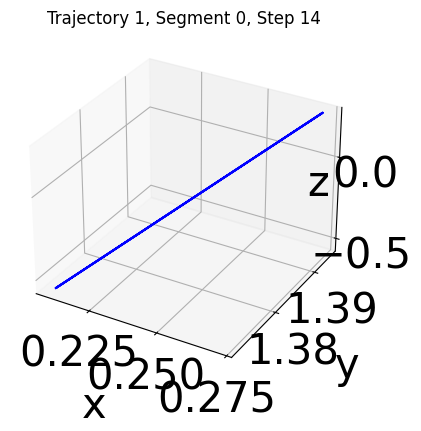

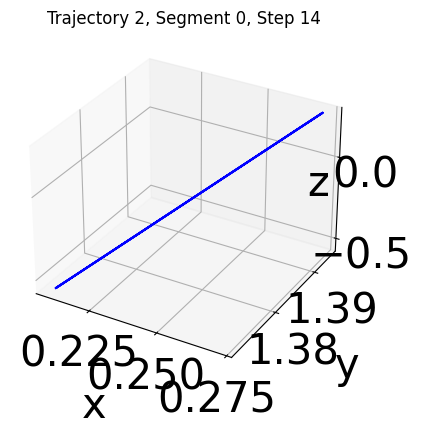

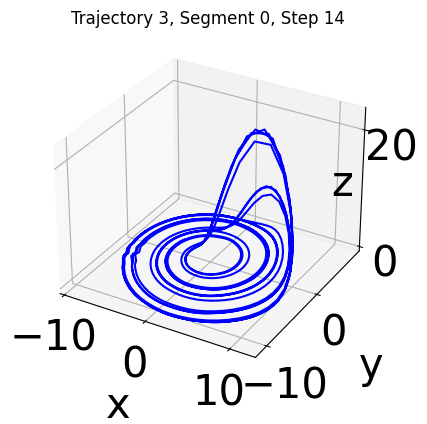

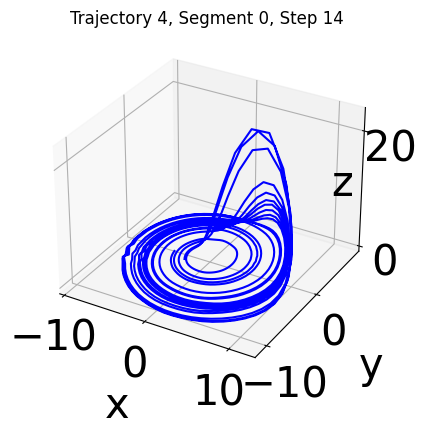

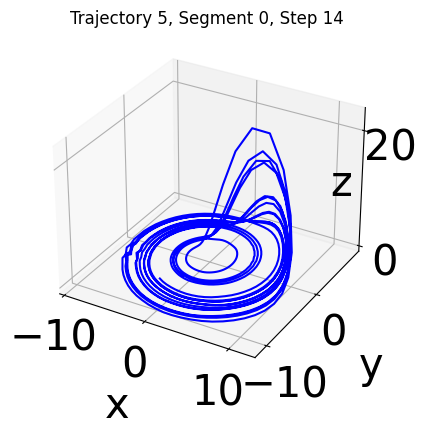

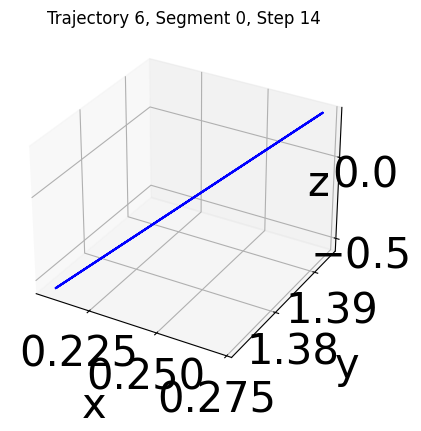

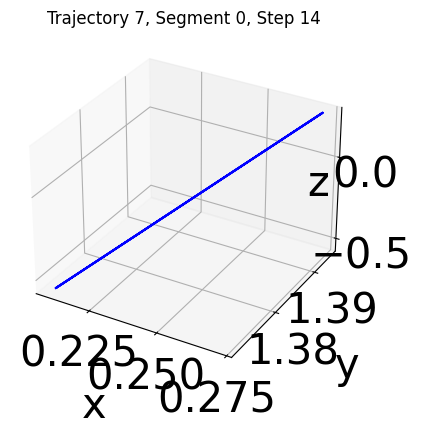

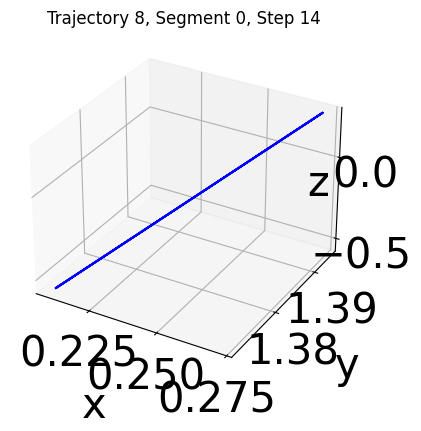

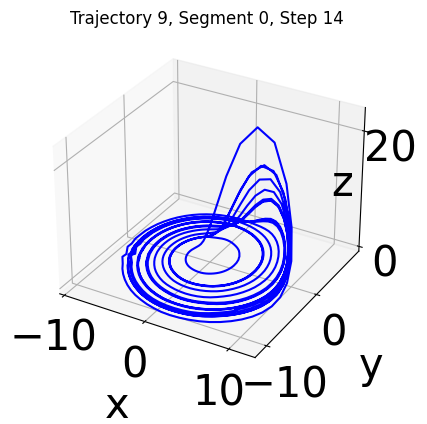

In [174]:
trajectorys_shifts = []
for traj_idx, traj in enumerate(ross_trajs):
    all_change = []
    for i in range(1):
        c = 0
        for j in range(14, 15):
            
            fig = plt.figure(figsize=(8, 4))
            ax = fig.add_subplot(projection='3d')
            ax.plot(traj[i][j][-1000:, 0], traj[i][j][-1000:, 1], traj[i][j][-1000:, 2], color="blue")

            ax.set_xlabel("x", size=30, labelpad=20)
            ax.set_ylabel("y", size=30, labelpad=20)
            ax.set_zlabel("z", size=30, labelpad=-30)

            ax.tick_params(axis='both', which='major', labelsize=30)
            plt.title(f'Trajectory {traj_idx}, Segment {i}, Step {j}')

            plt.tight_layout()

            plt.show()
                
        all_change.append(c)
    trajectorys_shifts.append(all_change)

In [ ]:
trajectorys_shifts = []
for traj_idx, traj in enumerate(li_sprott_trajs):
    all_change = []
    for i in range(10):
        c = 0
        for j in range(19):
            if (np.abs(np.fft.fft(traj[i][j][:, 0]))[:5] > 1500).any():
                c += 1
        all_change.append(c)
    trajectorys_shifts.append(all_change)

In [26]:
transposed = list(zip(*trajectorys_shifts))

In [27]:
trajectorys_shifts

[[1, 2, 0, 1, 0, 1, 0, 1, 0, 0],
 [1, 2, 0, 1, 1, 2, 0, 1, 0, 0],
 [1, 2, 1, 0, 2, 1, 1, 0, 0, 0],
 [0, 2, 1, 2, 0, 1, 1, 1, 0, 0],
 [0, 2, 1, 2, 2, 2, 2, 0, 1, 0],
 [0, 1, 1, 1, 1, 2, 0, 1, 0, 0],
 [1, 2, 0, 2, 1, 1, 0, 1, 0, 0],
 [1, 1, 1, 1, 1, 1, 0, 2, 0, 0],
 [1, 2, 0, 2, 1, 0, 0, 0, 0, 0],
 [0, 2, 0, 1, 1, 2, 0, 0, 0, 0]]

# Rossler

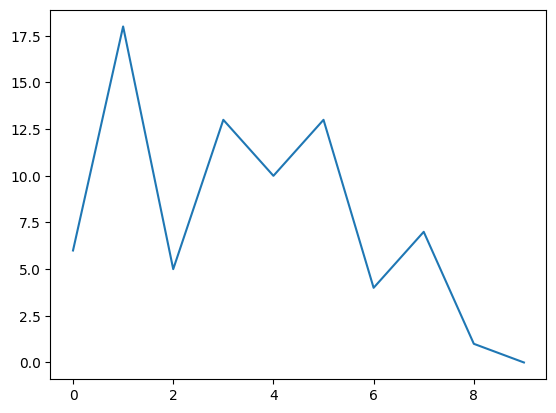

In [29]:
plt.plot(np.sum(trajectorys_shifts, axis=0))

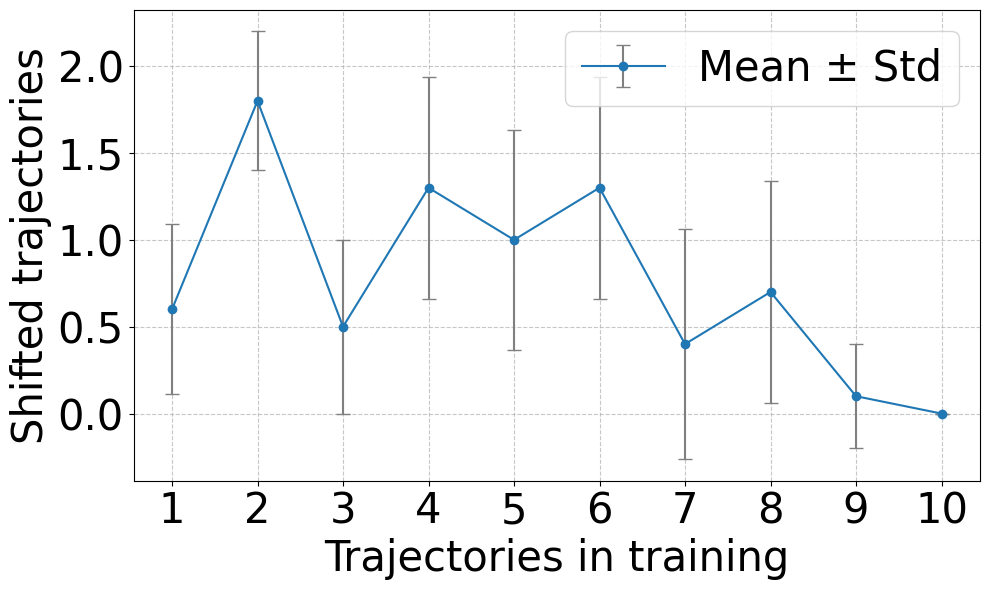

In [28]:
# Transpose to get time-step-wise values
means = [np.mean(step) for step in transposed]
stds = [np.std(step) for step in transposed]

# Plot
plt.figure(figsize=(10, 6))
plt.errorbar(
    x=range(1, 11),
    y=means,
    yerr=stds,
    fmt='-o',
    ecolor='gray',
    capsize=5,
    label='Mean ± Std'
)

#plt.title('Trend of Values Across Time Steps with Variability')
plt.xlabel('Trajectories in training', fontsize=30)
plt.ylabel('Shifted trajectories', fontsize=30)
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(range(1, 11), fontsize=30)
plt.yticks(fontsize=30)

plt.legend(fontsize=30)
plt.tight_layout()
plt.show()


# Li-Sprott

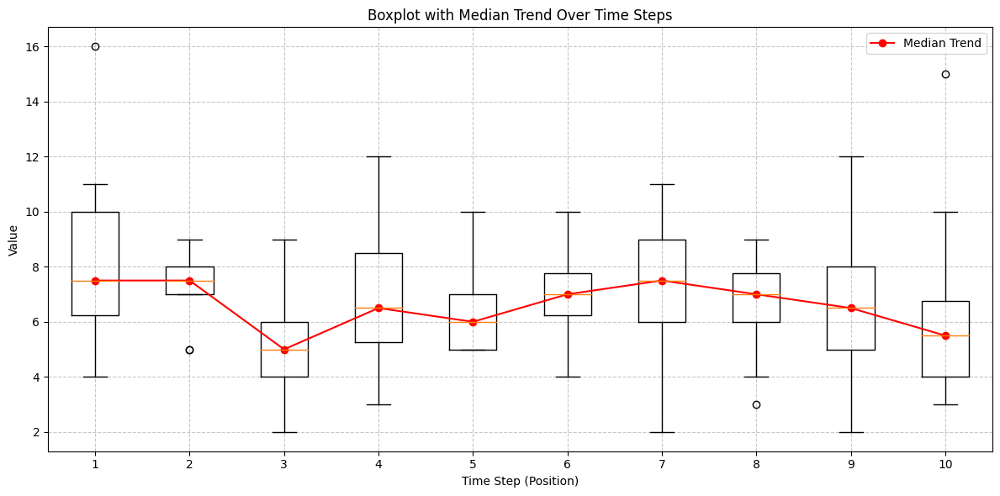

In [22]:
plt.figure(figsize=(12, 6))
plt.boxplot(transposed)
medians = [np.median(step) for step in transposed]
plt.plot(range(1, 11), medians, color='red', marker='o', label='Median Trend')
plt.title('Boxplot with Median Trend Over Time Steps')
plt.xlabel('Time Step (Position)')
plt.ylabel('Value')
plt.xticks(range(1, 11))
plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.tight_layout()
plt.show()

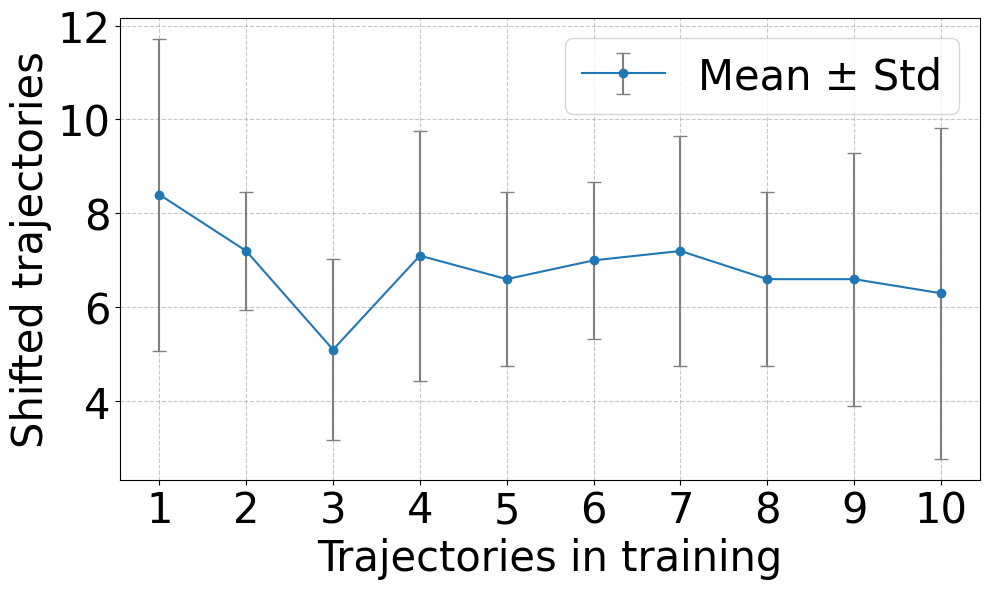

In [21]:
# Transpose to get time-step-wise values
means = [np.mean(step) for step in transposed]
stds = [np.std(step) for step in transposed]

# Plot
plt.figure(figsize=(10, 6))
plt.errorbar(
    x=range(1, 11),
    y=means,
    yerr=stds,
    fmt='-o',
    ecolor='gray',
    capsize=5,
    label='Mean ± Std'
)

#plt.title('Trend of Values Across Time Steps with Variability')
plt.xlabel('Trajectories in training', fontsize=30)
plt.ylabel('Shifted trajectories', fontsize=30)
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(range(1, 11), fontsize=30)
plt.yticks(fontsize=30)

plt.legend(fontsize=30)
plt.tight_layout()
plt.show()


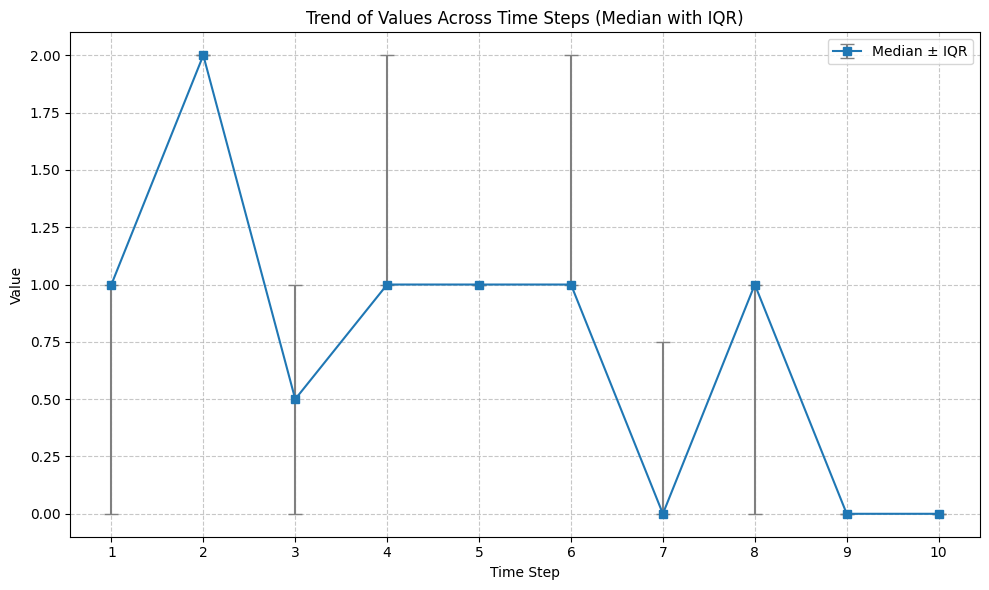

In [35]:
medians = [np.median(step) for step in transposed]
iqr_lower = [np.percentile(step, 25) for step in transposed]
iqr_upper = [np.percentile(step, 75) for step in transposed]
iqr_error = [ [med - low, up - med] for med, low, up in zip(medians, iqr_lower, iqr_upper) ]
lower_err, upper_err = zip(*iqr_error)

plt.figure(figsize=(10, 6))
plt.errorbar(
    x=range(1, 11),
    y=medians,
    yerr=[lower_err, upper_err],
    fmt='-s',
    ecolor='gray',
    capsize=5,
    label='Median ± IQR'
)

plt.title('Trend of Values Across Time Steps (Median with IQR)')
plt.xlabel('Time Step')
plt.ylabel('Value')
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(range(1, 11))
plt.legend()
plt.tight_layout()
plt.show()


# Examples

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


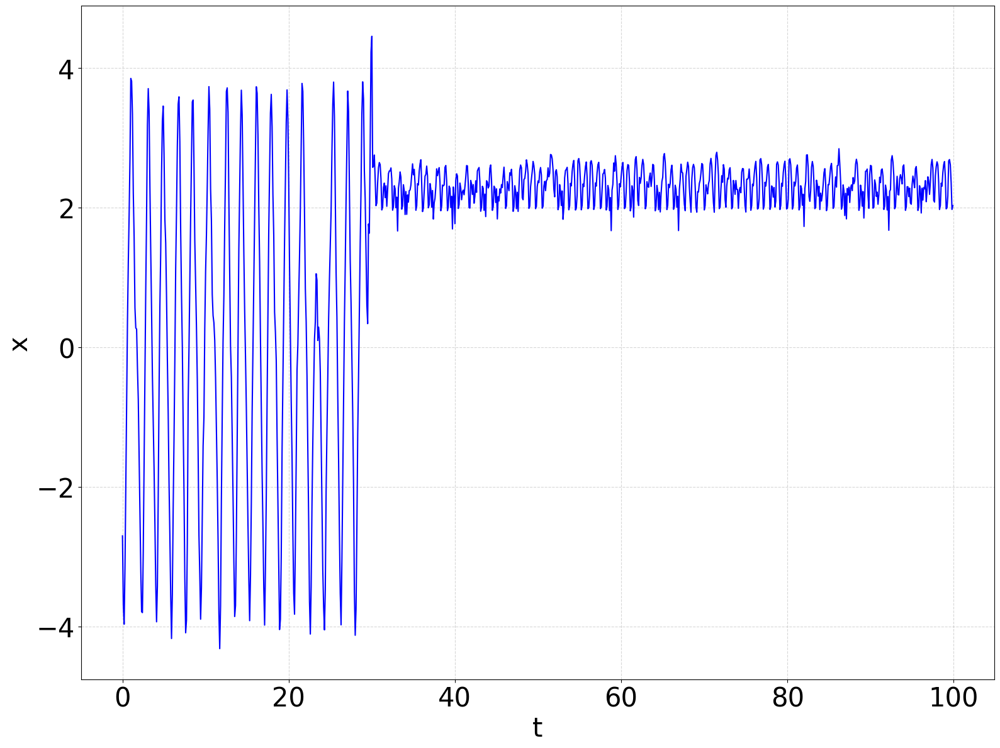

In [30]:
plt.figure(figsize=(16, 12))
plt.plot(np.arange(0, 100, 0.1), li_sprott_trajs[0][0][7][1000:2000, 0], c="blue")
# Style for publication
plt.xlabel('t', fontsize=30)
plt.ylabel('x', fontsize=30)
#plt.title('Frequency Spectrum of Predicted Trajectory', fontsize=13)
plt.grid(True, which='both', linestyle='--', alpha=0.5)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.legend(frameon=False, fontsize=30)
plt.tight_layout()

plt.show()

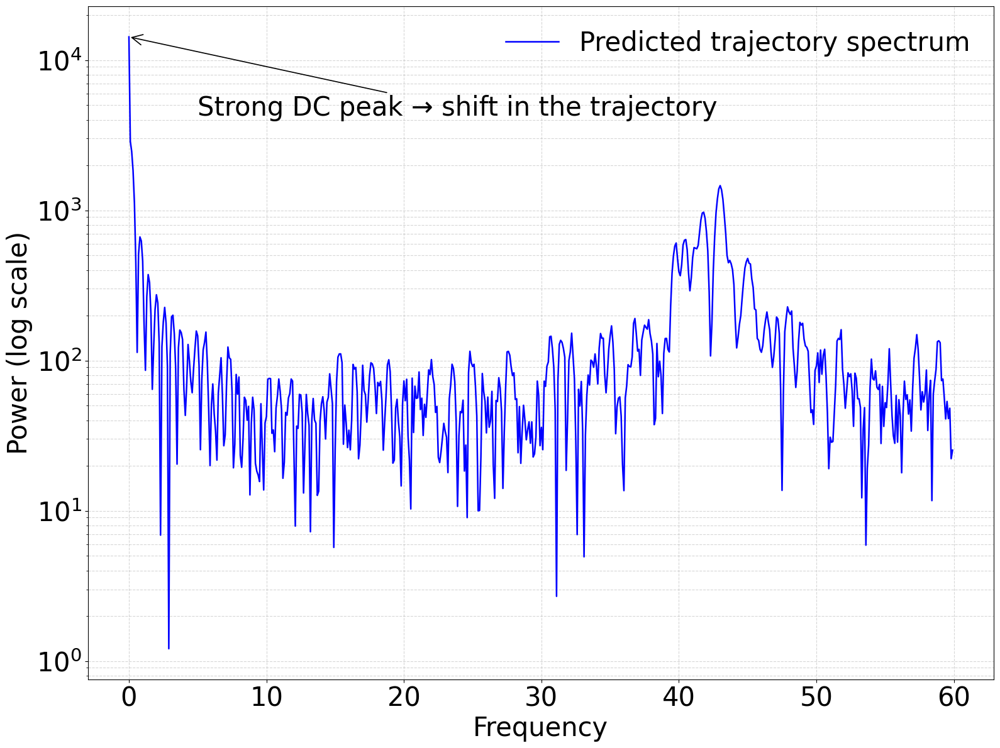

In [31]:
k = 600
spectrum = np.abs(np.fft.fft(li_sprott_trajs[0][0][7][:, 0]))[:k]
frequencies = np.arange(0, k // 10, 0.1)

plt.figure(figsize=(16, 12))
plt.semilogy(frequencies, spectrum, label='Predicted trajectory spectrum', linewidth=1.8, c="blue")

# Annotate DC peak
plt.annotate('Strong DC peak → shift in the trajectory',
             xy=(frequencies[0], spectrum[0]),
             xytext=(5, spectrum[0] * 0.3),
             arrowprops=dict(arrowstyle='->', lw=1.2),
             fontsize=30)

# Style for publication
plt.xlabel('Frequency', fontsize=30)
plt.ylabel('Power (log scale)', fontsize=30)
#plt.title('Frequency Spectrum of Predicted Trajectory', fontsize=13)
plt.grid(True, which='both', linestyle='--', alpha=0.5)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.legend(frameon=False, fontsize=30)
plt.tight_layout()

plt.show()

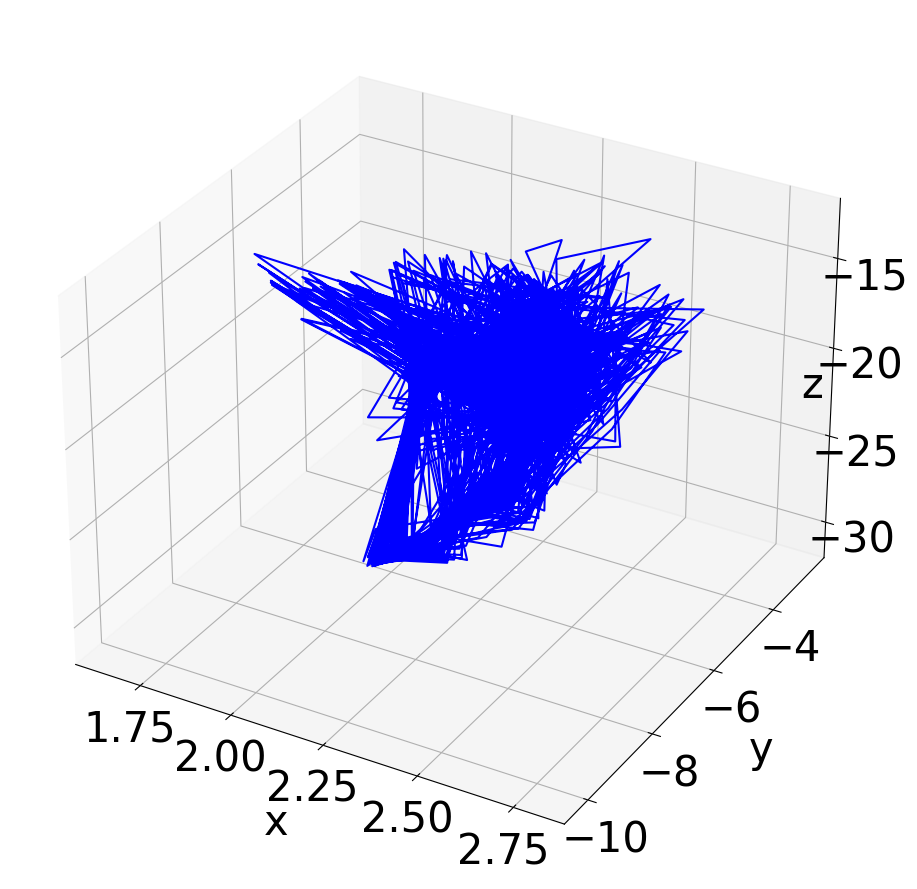

In [57]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(li_sprott_trajs[0][0][7][6000:, 0], li_sprott_trajs[0][0][7][6000:, 1], li_sprott_trajs[0][0][7][6000:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

In [33]:
loaded_data = np.load("predicts/all201_matrices_predictsRosslerLong.npz")
all_matrices_predicts = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


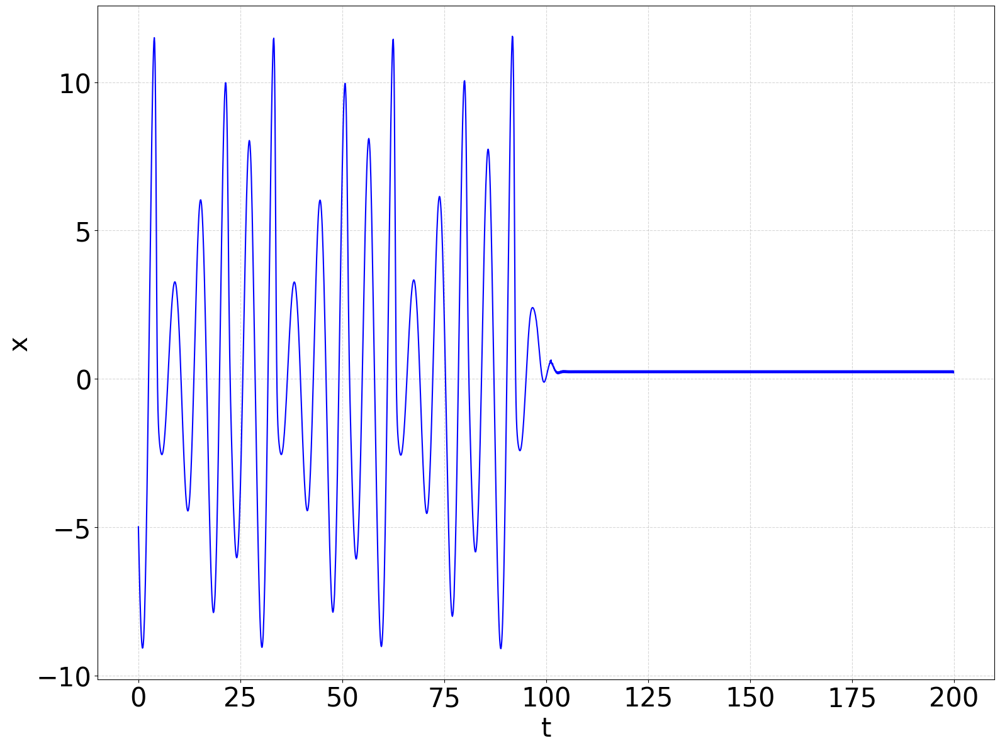

In [101]:
plt.figure(figsize=(16, 12))
plt.plot(np.arange(0, 200, 0.1), all_matrices_predicts[0][14][14000:16000, 0], c="blue")
# Style for publication
plt.xlabel('t', fontsize=30)
plt.ylabel('x', fontsize=30)
#plt.title('Frequency Spectrum of Predicted Trajectory', fontsize=13)
plt.grid(True, which='both', linestyle='--', alpha=0.5)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.legend(frameon=False, fontsize=30)
plt.tight_layout()

plt.show()

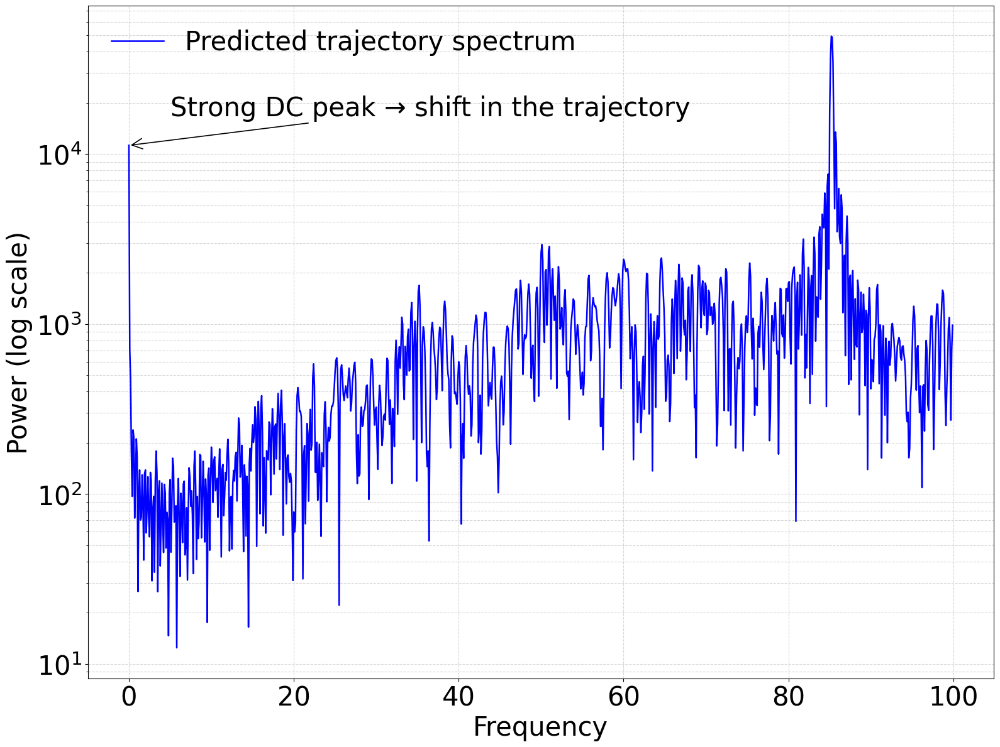

In [34]:
k = 1000
spectrum = np.abs(np.fft.fft(all_matrices_predicts[0][14][:, 0]))[:k]
frequencies = np.arange(0, k // 10, 0.1)

plt.figure(figsize=(16, 12))
plt.semilogy(frequencies, spectrum, label='Predicted trajectory spectrum', linewidth=1.8, c="blue")

# Annotate DC peak
plt.annotate('Strong DC peak → shift in the trajectory',
             xy=(frequencies[0], spectrum[0]),
             xytext=(5, spectrum[0] * 1.5),
             arrowprops=dict(arrowstyle='->', lw=1.2),
             fontsize=30)

# Style for publication
plt.xlabel('Frequency', fontsize=30)
plt.ylabel('Power (log scale)', fontsize=30)
#plt.title('Frequency Spectrum of Predicted Trajectory', fontsize=13)
plt.grid(True, which='both', linestyle='--', alpha=0.5)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.legend(frameon=False, fontsize=30)
plt.tight_layout()

plt.show()

# Li-Sprott attractor pictures

In [13]:
from scipy.integrate import solve_ivp


In [11]:
a = 6
b = 0.1
def LiSprott(t, X):
    x, y, z, u = X
    return np.array([y - x,
                     -x * z + u,
                     x * y - a,
                     -b * y])

In [23]:
start_point = np.array([0, 4, 0, -5])
attractor_old = solve_ivp(LiSprott, [0, 1000], 
                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True).y

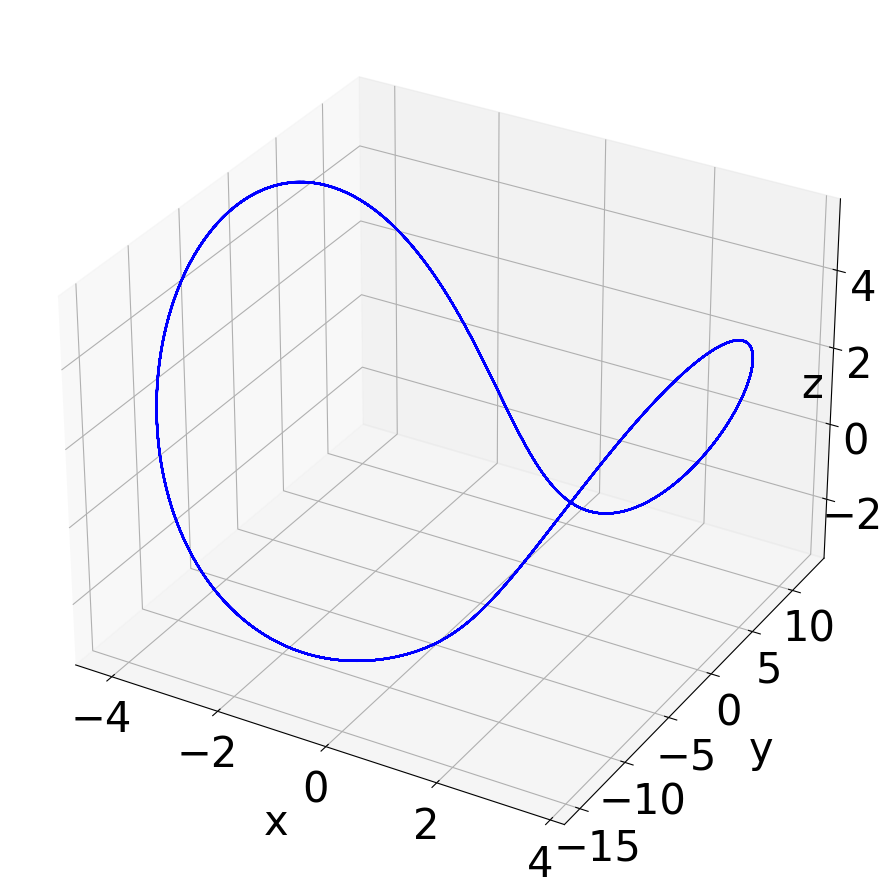

In [24]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
t = 3000
t_end = 6000
ax.plot(attractor_old[0][t:t_end], attractor_old[1][t:t_end], attractor_old[2][t:t_end], color="blue")


ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

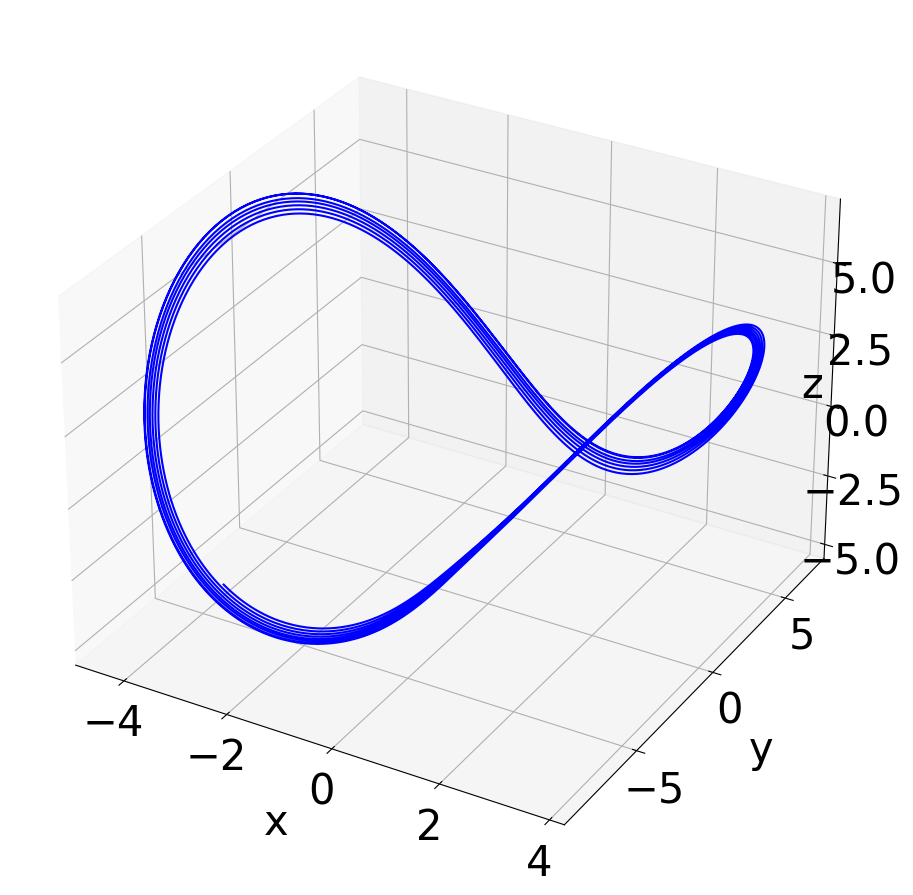

In [25]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
t = 3000
t_end = 6000
ax.plot(thorus[0][t:t_end], thorus[1][t:t_end], thorus[2][t:t_end], color="blue")


ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

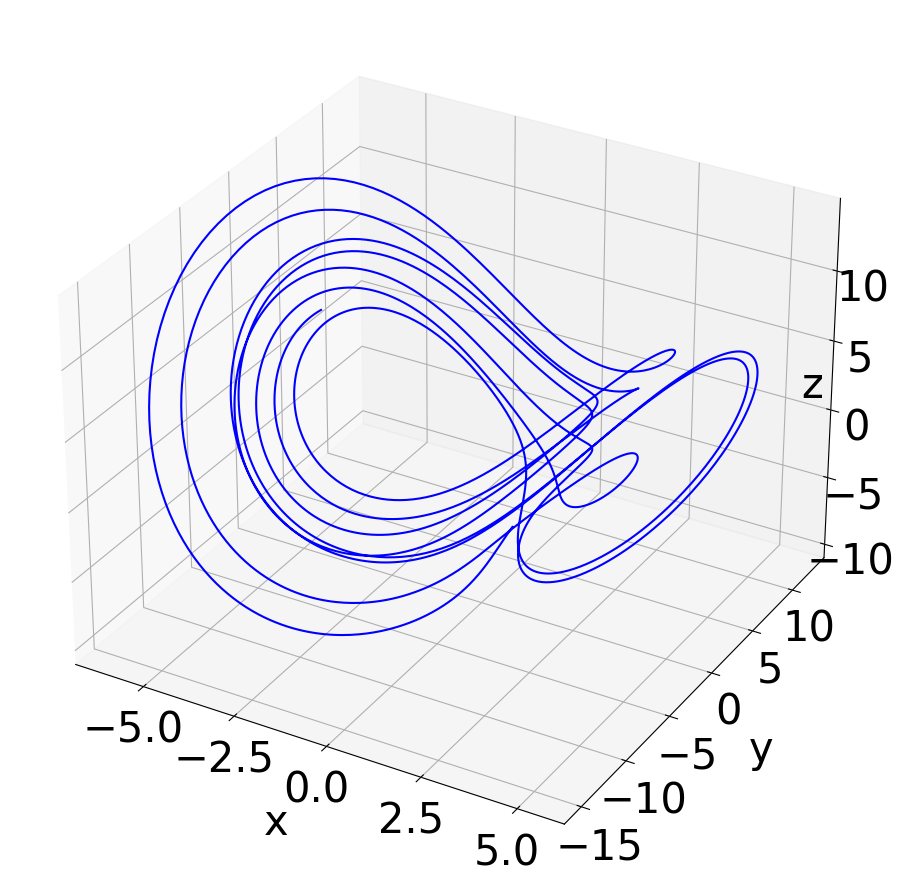

In [21]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
t = 3000
t_end = 6000
ax.plot(attractor1[0][t:t_end], attractor1[1][t:t_end], attractor1[2][t:t_end], color="blue")


ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

In [14]:
start_point = np.array([0, 4, 0, -5])
attractor1 = solve_ivp(LiSprott, [0, 1000], 
                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True).y

start_point = np.array([0, -4, 0, 5])
attractor2 = solve_ivp(LiSprott, [0, 1000], 
                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True).y

start_point = np.array([1, -1, 1, -1])
thorus = solve_ivp(LiSprott, [0, 1000], 
                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True).y

In [15]:
import plotly.graph_objects as go

t = 3000
t_end = 6000

fig = go.Figure()

# Добавляем траектории
fig.add_trace(go.Scatter3d(
    x=attractor1[0][t:t_end], y=attractor1[1][t:t_end], z=attractor1[2][t:t_end],
    mode='lines',
    line=dict(color='blue', width=3),
    name='Attractor 1'
))

fig.add_trace(go.Scatter3d(
    x=attractor2[0][t:t_end], y=attractor2[1][t:t_end], z=attractor2[2][t:t_end],
    mode='lines',
    line=dict(color='red', width=3),
    name='Attractor 2'
))

fig.add_trace(go.Scatter3d(
    x=thorus[0][t:t_end], y=thorus[1][t:t_end], z=thorus[2][t:t_end],
    mode='lines',
    line=dict(color='green', width=3),
    name='Torus'
))

# Настройка макета
fig.update_layout(
    scene=dict(
        xaxis=dict(
            title_text='x',
            title_font=dict(size=30),
            tickfont=dict(size=15),
        ),
        yaxis=dict(
            title_text='y',
            title_font=dict(size=30),
            tickfont=dict(size=15),
        ),
        zaxis=dict(
            title_text='z',
            title_font=dict(size=30, family="Arial", color="black"),
            tickfont=dict(size=15),
        ),
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.5)
        ),
    ),
    margin=dict(l=50, r=50, b=50, t=50),  # Увеличиваем отступы, чтобы подписи не обрезались
    width=1000,
    height=800,
)

fig.show()

In [10]:
import plotly.graph_objects as go

li_sprott_traj = li_sprott_trajs[0][0][0].T
t = 3000
t_end = 4000

fig = go.Figure()


# Добавляем траектории
fig.add_trace(go.Scatter3d(
    x=li_sprott_traj[0][t:t_end], y=li_sprott_traj[1][t:t_end], z=li_sprott_traj[2][t:t_end],
    mode='lines',
    line=dict(color='blue', width=3),
    name='Attractor 1'
))

# Настройка макета
fig.update_layout(
    scene=dict(
        xaxis=dict(
            title_text='x',
            title_font=dict(size=30),
            tickfont=dict(size=15),
            range=[-10, 10]
        ),
        yaxis=dict(
            title_text='y',
            title_font=dict(size=30),
            tickfont=dict(size=15),
            range=[-15, 15]
        ),
        zaxis=dict(
            title_text='z',
            title_font=dict(size=30, family="Arial", color="black"),
            tickfont=dict(size=15),
            range=[-15, 15]
        ),
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.5)
        ),
    ),
    margin=dict(l=50, r=50, b=50, t=50),  # Увеличиваем отступы, чтобы подписи не обрезались
    width=1000,
    height=800,
)

fig.show()

# Rossler Picture

In [9]:
rs_traj = np.load("data/Rossler0_01Step0.npy")

import plotly.graph_objects as go

t = 0
t_end = -1

fig = go.Figure()

# Добавляем траектории
fig.add_trace(go.Scatter3d(
    x=rs_traj[0][t:t_end], y=rs_traj[1][t:t_end], z=rs_traj[2][t:t_end],
    mode='lines',
    line=dict(color='blue', width=3),
    name='Attractor 1'
))

# Настройка макета
fig.update_layout(
    scene=dict(
        xaxis=dict(
            title_text='x',
            title_font=dict(size=30),
            tickfont=dict(size=15),
        ),
        yaxis=dict(
            title_text='y',
            title_font=dict(size=30),
            tickfont=dict(size=15),
        ),
        zaxis=dict(
            title_text='z',
            title_font=dict(size=30, family="Arial", color="black"),
            tickfont=dict(size=15),
        ),
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.5)
        ),
    ),
    margin=dict(l=50, r=50, b=50, t=50),  # Увеличиваем отступы, чтобы подписи не обрезались
    width=1000,
    height=800,
)

fig.show()


In [6]:
rs_traj = ross_trajs[0][0][0].T

import plotly.graph_objects as go

t = 0
t_end = -1

fig = go.Figure()

# Добавляем траектории
fig.add_trace(go.Scatter3d(
    x=rs_traj[0][t:t_end], y=rs_traj[1][t:t_end], z=rs_traj[2][t:t_end],
    mode='lines',
    line=dict(color='blue', width=3),
    name='Attractor 1'
))

# Настройка макета
fig.update_layout(
    scene=dict(
        xaxis=dict(
            title_text='x',
            title_font=dict(size=30),
            tickfont=dict(size=15),
        ),
        yaxis=dict(
            title_text='y',
            title_font=dict(size=30),
            tickfont=dict(size=15),
        ),
        zaxis=dict(
            title_text='z',
            title_font=dict(size=30, family="Arial", color="black"),
            tickfont=dict(size=15),
        ),
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.5)
        ),
    ),
    margin=dict(l=50, r=50, b=50, t=50),  # Увеличиваем отступы, чтобы подписи не обрезались
    width=1000,
    height=800,
)

fig.show()


# Lyapunov exponents

In [4]:
ls_traj = np.load("data/LiSprottNoNoise0_01StepCorrectSystem0.npy")
rs_traj = np.load("data/Rossler0_01Step0.npy")


In [ ]:
ls_traj.shape

In [5]:
import nolds

lyap_max_ls = nolds.lyap_e(ls_traj[0])
lyap_max_rs = nolds.lyap_e(rs_traj[0])



In [6]:
print("Li-Sprott Lyapunov Exponents", lyap_max_ls)
print("Rossler Lyapunov Exponents", lyap_max_rs)


Li-Sprott Lyapunov Exponents [ 0.02994632  0.00988958 -0.01324459 -0.03676434]
Rossler Lyapunov Exponents [ 0.00852839  0.00578681 -0.02216899 -0.06224681]


# Draft

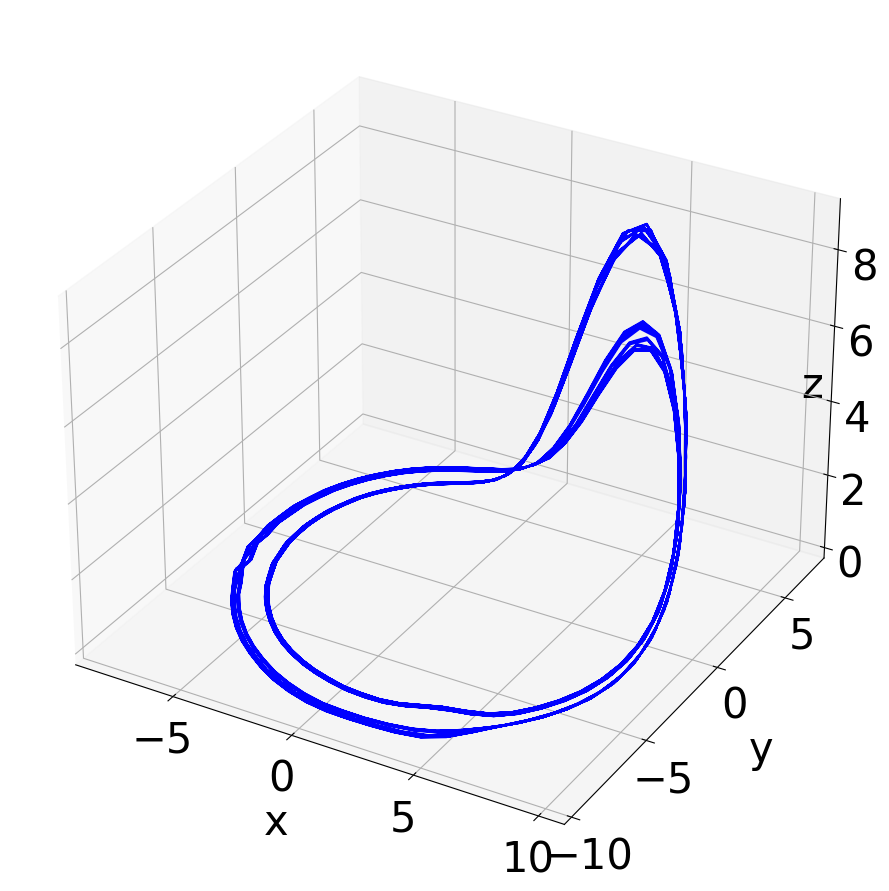

In [3]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(ross_trajs[2][2][7][5000:, 0], ross_trajs[2][2][7][5000:, 1], ross_trajs[2][2][7][5000:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()


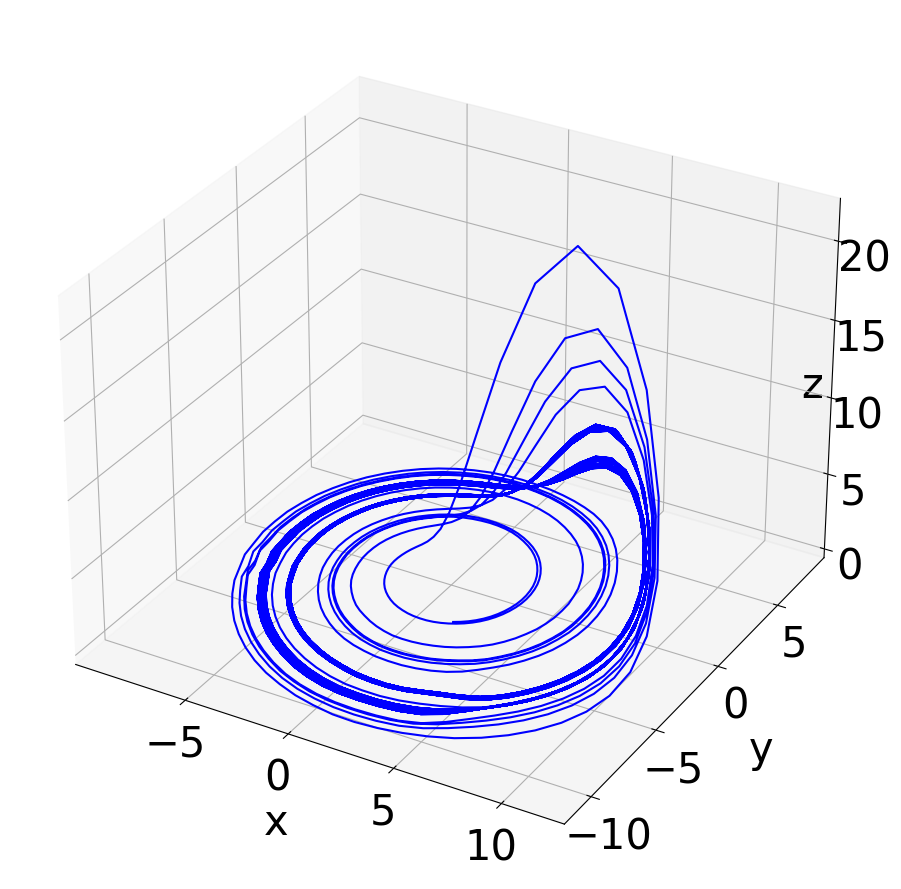

In [4]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(ross_trajs[2][2][7][:, 0], ross_trajs[2][2][7][:, 1], ross_trajs[2][2][7][:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()
